In [1]:
import matplotlib.pyplot as plt
from skimage import img_as_ubyte
from numpy import asarray
from PIL import Image
import os
import cv2
import matplotlib.pyplot as plt
from skimage import img_as_ubyte

In [ ]:
goodimgs=['0cb83059-d8ba-474c-a535-09b32d3d3472.jpg','0e36a0f3-7786-4de2-9e9c-4825599893ac.jpg',
          '000ec7f5-ba65-44f5-b423-8a0c500c1c41.jpg','1b0d4173-fd8c-4337-a188-edb89c34e99c.jpg',
          '2ad7445e-3446-433a-8248-98e5195c9313.jpg']
test_imgs=['2b77e5b1-0496-41a9-a9ef-f02b5ea7745f.jpg','2fa29d2a-7697-44d2-89ff-a513635a4e44.jpg',
         '3ad81c24-4d7f-46d3-b31e-435b8069ee49.jpg','3c529e37-176f-4824-a539-e288bb3f839d.jpg']

In [3]:
folderpath='/content/drive/My Drive/starfish/'

In [27]:
from PIL import Image
def load_images_from_folder(folder,num=None):
    images = []
    filenames=[]
    if num:
      dirs = os.listdir(folder)[:num]
    else:
      dirs =  os.listdir(folder)
    for filename in dirs:
        if filename.endswith(".jpg"):
            filenames.append(filename)
            img = Image.open(os.path.join(folder, filename)) # images are color images

            #img = cv2.imread(os.path.join(folder, filename), cv2.IMREAD_COLOR)
            # img=cv2.resize(img,(28,28),interpolation=cv2.INTER_AREA)
            if img is not None:
                images.append(img)
    return images,filenames

In [28]:
images,filenames = load_images_from_folder(folderpath)

##trial1

In [7]:
def img_measures(image):
  pixels = asarray(image)
  # convert from integers to floats
  pixels = pixels.astype('float32')
  # calculate global mean
  mean = pixels.mean()
  print('Mean: %.3f' % mean)
  print('Min: %.3f, Max: %.3f' % (pixels.min(), pixels.max()))
  print("####################################")
  # global centering of pixels
  pixels = pixels - mean
  # confirm it had the desired effect
  mean = pixels.mean()
  print('Mean: %.3f' % mean)
  print('Min: %.3f, Max: %.3f' % (pixels.min(), pixels.max()))
  print("####################################")


In [38]:
def whiteBalanced(originalimg,imgpixels):
  fig, ax = plt.subplots(1,2, figsize=(10,6))
  ax[0].imshow(originalimg)
  ax[0].set_title('Original Image')
  img_max = (imgpixels*0.5 / imgpixels.mean(axis=(0,1)))
  ax[1].imshow(img_max);
  ax[1].set_title('Whitebalanced Image');
  return img_max

In [36]:
def preprocessing(images):
  Copy_to_path="/content/drive/My Drive/Preprocessed_starfish/"
  for i,img in enumerate(images):
    pixels = asarray(img)
    pixels = pixels.astype('float32')
    mean = pixels.mean()
    #outside of our boundary which is least mean
    #and largest mean from the 5 chosen samples will be viewed
    if mean >= 116.930 or mean <= 86.338:
      img_max = whiteBalanced(img,pixels)
      cv2.imwrite(os.path.join(Copy_to_path,filenames[i]),img_as_ubyte(img_max.clip(0, 1)))
      #img_max.save(Copy_to_path+filenames[i]+".png") 
  return Copy_to_path
#plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

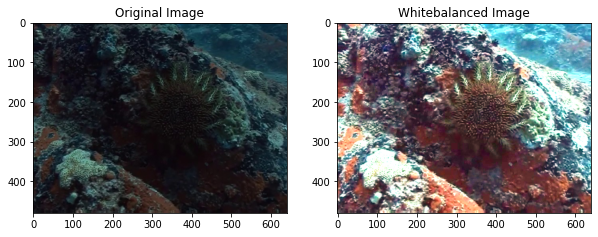

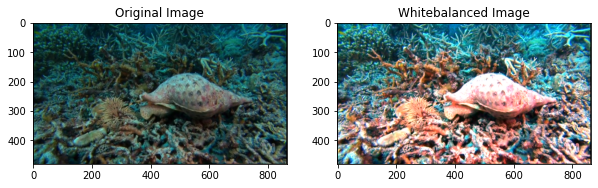

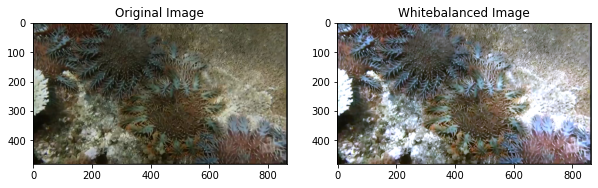

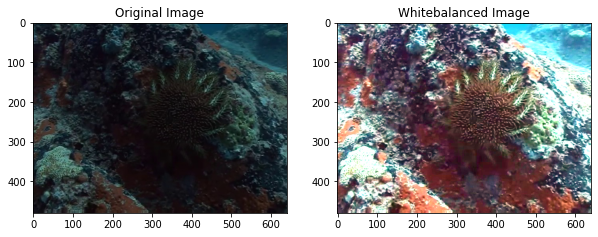

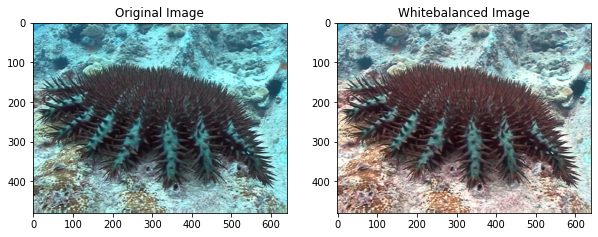

...

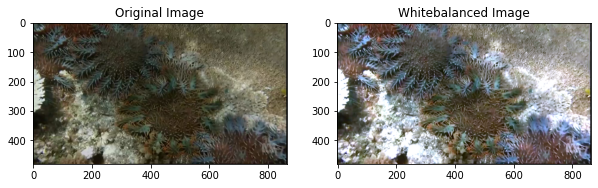

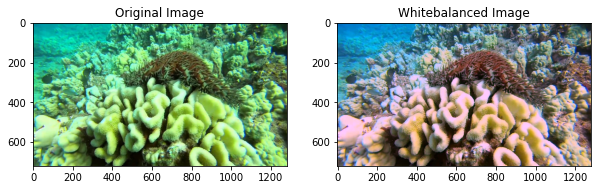

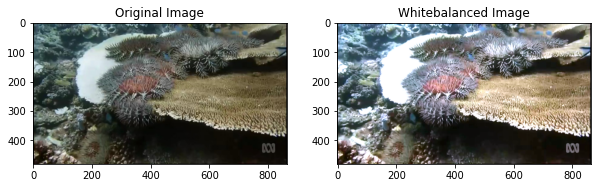

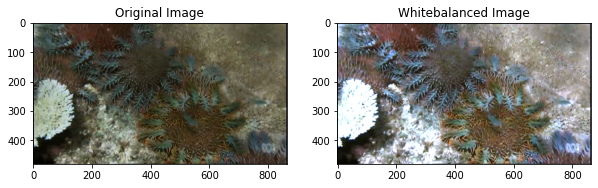

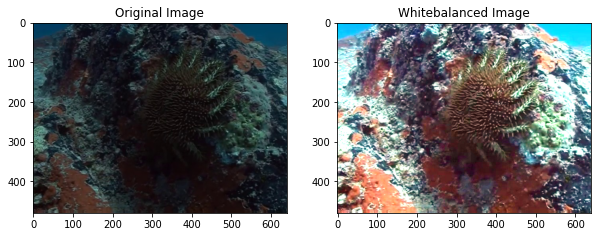

In [39]:
path = preprocessing(images)